In [1]:
using Pkg
Pkg.activate(".")

  Activating project at `c:\Users\mitch\OneDrive\Desktop\Julia Programs\Project3\Mitchell-Thinee-2504-2024-PROJECT3`


In [6]:
csv_file = CSV.File("data/Melbourne_housing_FULL.csv")
df = DataFrame(csv_file)
println("Data size: ", size(df))
println("Columns in the data: ", names(df))
println(first(df,10))

Data size: (34857, 21)
Columns in the data: ["Suburb", "Address", "Rooms", "Type", "Price", "Method", "SellerG", "Date", "Distance", "Postcode", "Bedroom2", "Bathroom", "Car", "Landsize", "BuildingArea", "YearBuilt", "CouncilArea", "Lattitude", "Longtitude", "Regionname", "Propertycount"]
10×21 DataFrame
 Row │ Suburb      Address             Rooms  Type     Price    Method   SellerG   Date       Distance  Postcode  Bedroom2  Bathroom  Car     Landsize  BuildingArea  YearBuilt  CouncilArea         Lattitude  Longtitude  Regionname             Propertycount 
     │ String31    String31            Int64  String1  Int64?   String3  String31  String15   String7   String7   Int64?    Int64?    Int64?  Int64?    Float64?      Int64?     String31            Float64?   Float64?    String31               String7       
─────┼────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────

As you can see above there is a large amount of data that is being handled in this dataframe. Some summary has been given above as to what the data looks like in each row.

## Task 1

In task one, we are required to create several splots and summaries for the following variables; Price, Number of Rooms, Landsize, Distance from the centre of Melbourne and method of sale. Below are a number of these type of plots with some analysis and trend identification. 

In [4]:

# Changing the Method names in the Dataframe to their actual, for plotting.
method_mapping = Dict("PI" => "Property passed in", 
                      "PN" => "Sold prior not Disclosed", 
                      "S" => "Property Sold",
                      "SA" => "Sold After Auction", 
                      "SN" => "Sold not Disclosed", 
                      "SP" => "Property Sold Prior",
                      "SS" => "Sold After Auction", 
                      "VB" => "Vendor Bid", 
                      "W" => "Withdrawn prior to Auction")


Dict{String, String} with 9 entries:
  "VB" => "Vendor Bid"
  "S"  => "Property Sold"
  "W"  => "Withdrawn prior to Auction"
  "SS" => "Sold After Auction"
  "PI" => "Property passed in"
  "PN" => "Sold prior not Disclosed"
  "SN" => "Sold not Disclosed"
  "SA" => "Sold After Auction"
  "SP" => "Property Sold Prior"

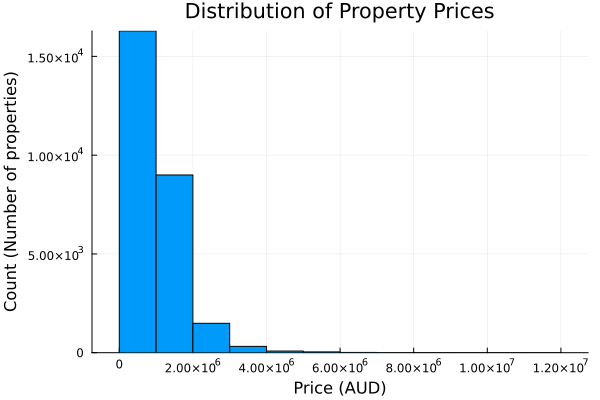

In [14]:
#Histogram of Price Distributions
histogram(df.Price, bins=20, xlabel="Price (AUD)",
          ylabel="Count (Number of properties)",label = "",
         title="Distribution of Property Prices")

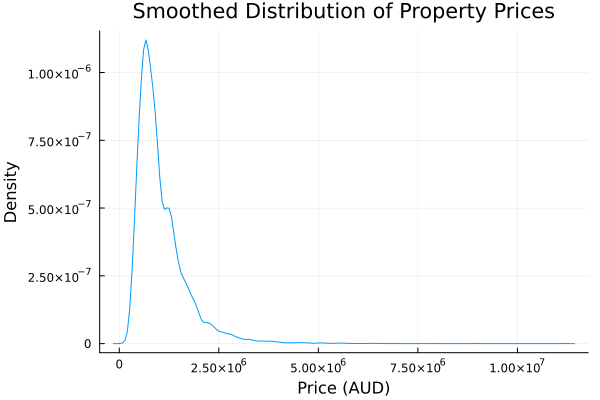

In [101]:
# Smooth histogram (density plot) for property prices
density(skipmissing(df.Price), xlabel="Price (AUD)", ylabel="Density",
        title="Smoothed Distribution of Property Prices", label="")

The  density values on the y-axis  above are are in the magnitude of 10^−6 to 10^−7.

The density plot is designed to show a probability density function (PDF) rather than counts. The y-axis values represent density per unit on the x-axis, meaning that the total area under the curve is 1. The values are so small due to the large range of prices, so even prices that occur more ofthen then others (closer to the 10^6 range) still occur quite infrequently because there are such a large range of prices that the properties are sold for. Since the area under the entire density curve must sum to 1, the values can become very small when the range of the x-axis is large.

Despite the values being quite small and over a large range we can still get an idea of where the majority of prices fall. This being in the 1 - 1.5 million dollar range. Doing statistical analysis will verify this point.

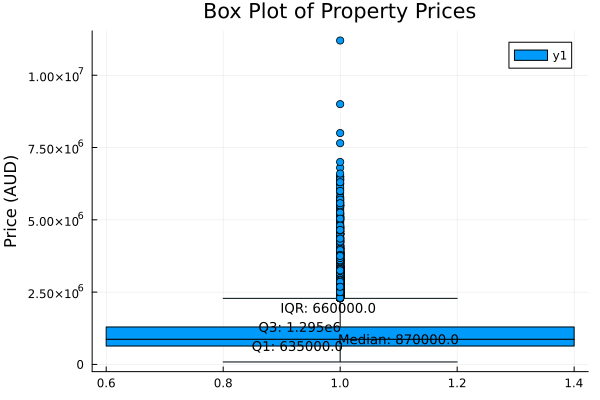

In [140]:

# Calculate the quartiles and IQR
quartiles = quantile(skipmissing(df.Price), [0.25, 0.5, 0.75])
iqr1 = quartiles[3] - quartiles[1]

# Create the box plot
boxplot(skipmissing(df.Price), xlabel="", ylabel="Price (AUD)", 
        title="Box Plot of Property Prices")

# Splitting up qaurtlies for plotting
q1 = quartiles[1]
q2 = quartiles[2]
q3 = quartiles[3]

# Annotate the quartiles and IQR with custom sizes and positions
annotate!(0.85, quartiles[1], text("Q1: $q1", 9, :left))   
annotate!(1.1, quartiles[2], text("Median: $q2", 9, :center)) 
annotate!(1.0, quartiles[3], text("Q3: $q3",9, :right))  
annotate!(0.9, quartiles[3] + iqr1, text("IQR: $iqr1", 9, :left))       

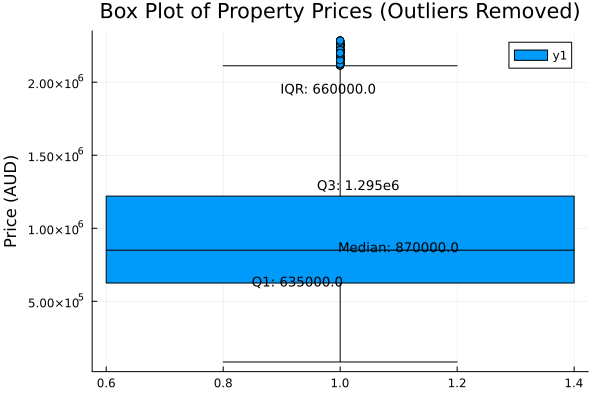

In [141]:


# Remove missing values and create a clean vector of prices
clean_prices = skipmissing(df.Price)

# Calculate the quartiles and IQR
quartiles = quantile(clean_prices, [0.25, 0.5, 0.75])
iqr_value = quartiles[3] - quartiles[1]

# Define lower and upper bounds for outlier removal  - to show the box plot better
lower_bound = quartiles[1] - 1.5 * iqr_value
upper_bound = quartiles[3] + 1.5 * iqr_value

# Filter the Price data to remove outliers
filtered_prices = filter(x -> x >= lower_bound && x <= upper_bound, clean_prices)

# Create the box plot
boxplot(filtered_prices, xlabel="", ylabel="Price (AUD)", 
        title="Box Plot of Property Prices (Outliers Removed)")

# Splitting up quartiles for plotting
q1 = quartiles[1]
q2 = quartiles[2]
q3 = quartiles[3]

# Annotate the quartiles and IQR with custom sizes and positions
annotate!(0.85, q1, text("Q1: $q1", 9, :left))   
annotate!(1.1, q2, text("Median: $q2", 9, :center)) 
annotate!(1.1, q3, text("Q3: $q3", 9, :right))  
annotate!(0.9, q3 + iqr_value, text("IQR: $iqr_value", 9, :left))  

Above is a statsitical insight into what can be obtained from the Price Data in the Dataframe. This boxplot gives a bit better insight and view of what each value in the interquartile range is. We can see that the median house price is $870 000 AUD. With 75% of houses being sold for less than $1,295,000 AUD.  Naturally, there are a large number of outliers whci hcan be seen on the boxplot above, whicha re removed for better viewing in this plot. The outliers drive up the mean and make it a less accurate form of central measure.

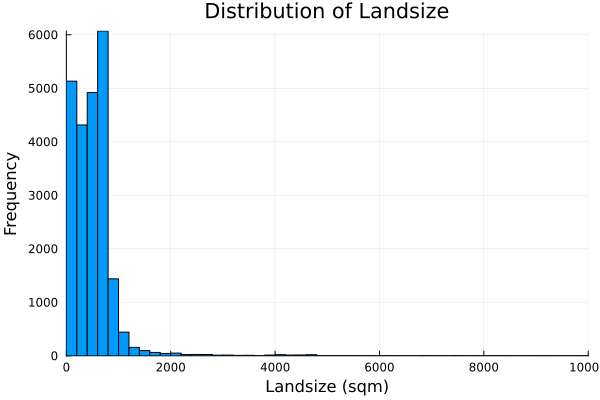

In [127]:
# Skip missing values directly in the plotting functions
histogram(skipmissing(df.Landsize), bins=2000, 
    xlabel="Landsize (sqm)", ylabel="Frequency", 
    title="Distribution of Landsize",
    xlims=(0, 10000), label = "")  # Adjust x-limits as needed

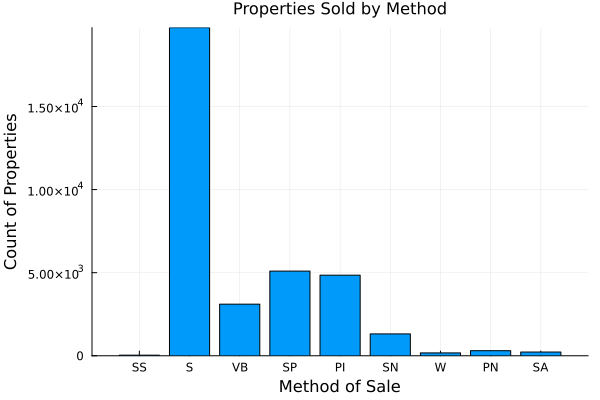

In [74]:
# Count the number of properties sold by method, skipping missing values
method_counts = combine(groupby(df, :Method), nrow => :Count)

# Create the bar plot for the number of properties sold by method
bar(method_counts.Method, method_counts.Count,
    xlabel="Method of Sale", ylabel="Count of Properties", 
    title="Properties Sold by Method",
    titlefontsize=11, legend=false)

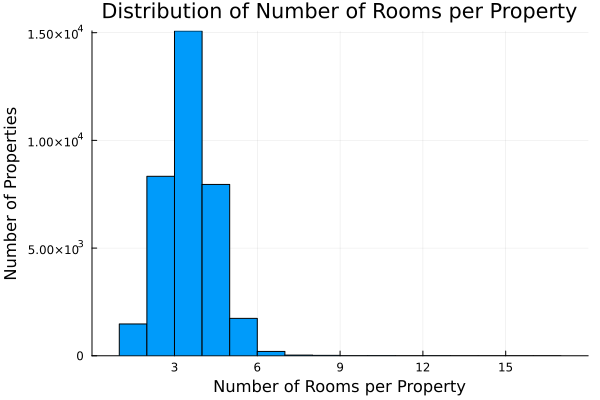

In [86]:
# Rooms
histogram(df.Rooms, xlabel="Number of Rooms per Property",
             ylabel="Number of Properties", bins = 20,
             title="Distribution of Number of Rooms per Property",
             label = "")


The above plot gives a good indication of how many rooms are in each property. A vast majorty have 2,3 and 4 rooms and this is present in the plot. With the vast majority of properties being townhouses and houses. There are a couple of outliers however, we can not be seen clearly on the graph, due to the scale. Some stats are included below to highlight this dominance of 3 bedroom houses in Melbourne.

In [168]:
rooms_data = skipmissing(df.Rooms)
mean_rooms = mean(rooms_data)
median_rooms = median(rooms_data)
mode_rooms = mode(rooms_data)
quartiles = quantile(rooms_data, [0.25, 0.75])
iqr_rooms = quartiles[2] - quartiles[1]  # Interquartile range
std_dev_rooms = std(rooms_data)


# Annotate with statistics
println("Mean: $mean_rooms")
println("Median: $median_rooms")
println("Mode: $mode_rooms")
println("IQR: $iqr_rooms")
println("Std Dev: $std_dev_rooms")


Mean: 3.0310124221820582
Median: 3.0
Mode: 3
IQR: 2.0
Std Dev: 0.9699329348975181


A Standard deviation of around 1, suggests that two-thirds of data points lie within 2-4 bedrooms which is expected from the pplots and what is expected with house sizes in cities.

Below is a section of code which is setp up in order to present the distance for CBD code tor task 2. This section was impelemtned before distance in Task 1, hence it is inculded here, as task 1 was created after it and based off of it.

In [150]:
# Function to convert Distance strings to Float64 and handle errors like "NA" strings.
function clean_distance(distance)
    return try
        parse(Float64, distance)
    catch
        return missing  # Return missing for any parsing issues
    end
end

# Clean the Distance column
plotting_distance = [clean_distance(d) for d in df.Distance if d != "missing"]

# Create a new DataFrame for plotting
# This Dataframe only includes rows with non-missing values for both Distance and Price.
cleaned_df = DataFrame(Distance = plotting_distance, Price = df.Price)
cleaned_df = cleaned_df[.!ismissing.(cleaned_df.Distance) .& .!ismissing.(cleaned_df.Price), :]

Row,Distance,Price
,Float64?,Int64?
1,2.5,1480000
2,2.5,1035000
3,2.5,1465000
4,2.5,850000
5,2.5,1600000
6,2.5,941000
7,2.5,1876000
8,2.5,1636000
9,2.5,1000000


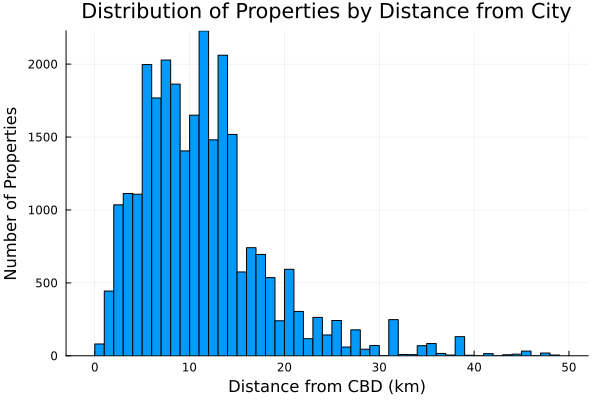

In [149]:
# Create a histogram of the Distance data
histogram(cleaned_df.Distance,
    xlabel = "Distance from CBD (km)", ylabel = "Number of Properties",
    title = "Distribution of Properties by Distance from City",
    bins = 50,  # Adjust the number of bins as needed
    legend = false)

The intetnion of the below segment is to present some statistical analysis of the distances and show where all values are distrubted about the mean.  Statistical values are presented below, but also plotted to show how the values are distributed.

Mean Distance: 11.280276003817063 km
Standard Deviation: 6.787468996334025 km
Min Distance: 0.0 km
Max Distance: 48.1 km


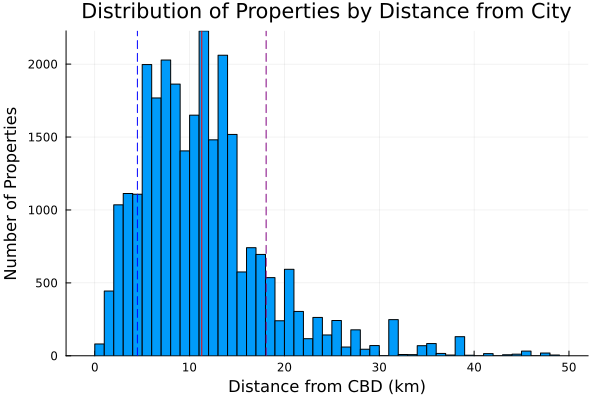

In [171]:
# Calculate stats
mean_distance = mean(cleaned_df.Distance)
std_d = std(cleaned_df.Distance)
min_distance = minimum(cleaned_df.Distance)
max_distance = maximum(cleaned_df.Distance)

# Print stats
println("Mean Distance: $mean_distance km")
println("Standard Deviation: $std_distance km")
println("Min Distance: $min_distance km")
println("Max Distance: $max_distance km")

histogram(cleaned_df.Distance,
    xlabel = "Distance from CBD (km)", ylabel = "No. of Properties",
    title = "Distribution of Properties by Distance from CBD",
    bins = 50,  
    legend = false)

# lines for mean and standard deviation
vline!([mean_distance], label="Mean", color=:red)
vline!([mean_distance + std_d], label="Mean + 1 Std Dev", color=:purple, linestyle=:dash)
vline!([mean_distance - std_d], label="Mean - 1 Std Dev", color=:blue, linestyle=:dash)

## Task 2

Task 2 requries us to plot the Average House Price as a function of the House size (No. of rooms, Landsize, etc.) and the Distance from the city, plus a combination of theses variables. Initially the plots consist of 2 variables with more complex trends plotted after. Some trends that are just of multiple variables are considered as well, for a different perspective. 

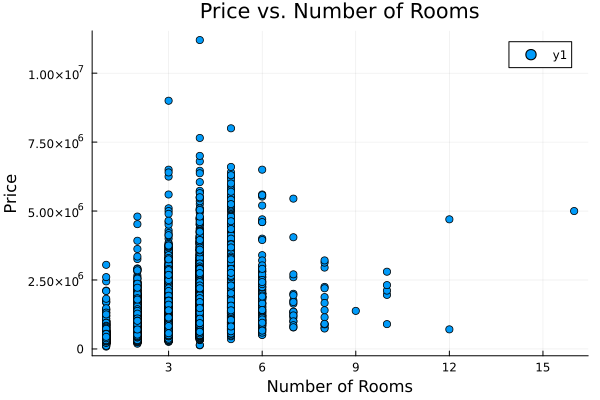

In [8]:

# Scatterplot of The price of Property compared to the number of rooms
scatter(df.Rooms, df.Price, xlabel="Number of Rooms", ylabel="Price", title="Price vs. Number of Rooms")

Clearly a large number of houses are sold with between 1 and 7 bedrooms as expected. These prices vary signifcantly as well, as observed above. Clearly, some houses with upwards of 12 rooms, are sold for less than some with 3 bedrooms. This encourages further investigation into other trends, such as distance to the city and landsize associated with these properties. 

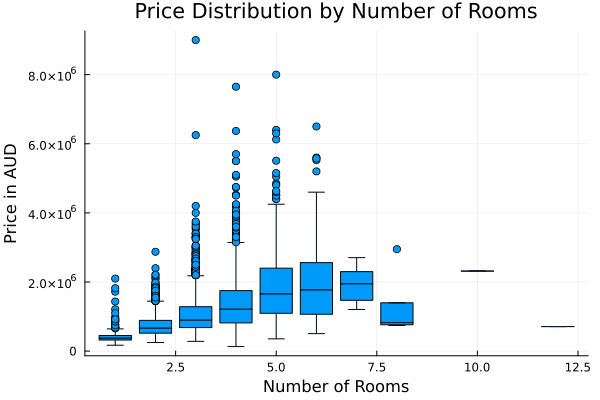

In [190]:
# Remove the missing values for plotting
clean_df = dropmissing(df)
# Boxplot of Price by Number of Rooms
@df clean_df boxplot(:Rooms, :Price, xlabel="Number of Rooms",
                      ylabel="Price in AUD", label = "",
                      title="Price Distribution by Number of Rooms")

The following plot allows for some insights. It can be seen that as expected, the average price of property does increase  with the number of rooms in the house. It can be seen that as the room number inncreases from 3 rooms to 7 rooms in a house, the prices close to doubles. A number of outliers are present on the plot as well  - due to the alrge number of data points in the dataframe. 

Below are a number of plots of two variables which show how the price of a propeerty increases with a number of indicators of house size.

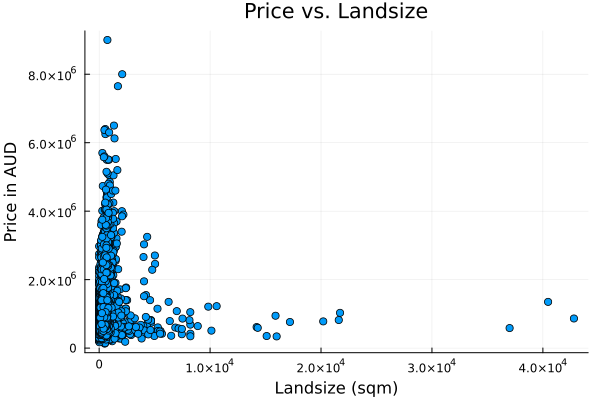

In [195]:
# 1. Scatterplot: Price vs. Landsize
@df clean_df scatter(:Landsize, :Price, label = "", xlabel="Landsize (sqm)", ylabel="Price in AUD", title="Price vs. Landsize")

The following plot does not all for a large number of insights. A statistical analysis will be required to truly assess the trend. Clearly the maximum landsize is around 40000 sqaure metres, and has not attracted a really signifcant price like some of the properties with much less land size. 

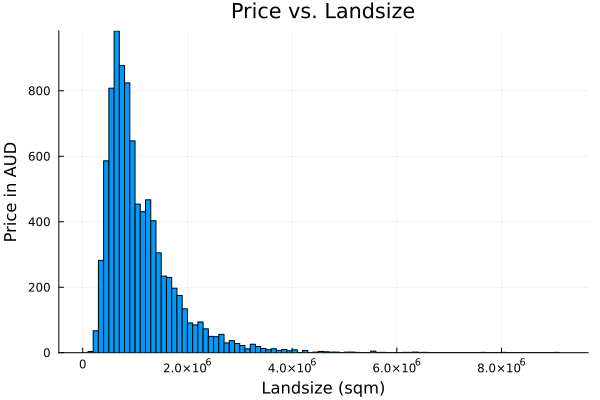

In [194]:
# 1. Histogram Price vs. Landsize
@df clean_df histogram(:Landsize, :Price, label = "", xlabel="Landsize (sqm)", ylabel="Price in AUD", title="Price vs. Landsize")

The plot above shows a semi-normally distrubted plot for landsize. This is intruging as you would believe that properties, particualry in a city are either quite small and surburban or large and out in the more regional areas. Nonetheless,  it can be clearly seen that there are a lot more proerties with less landsize and as a result a greater range of property costs. This has resulted in larger prices for less landsize - a seemingly strange trend.

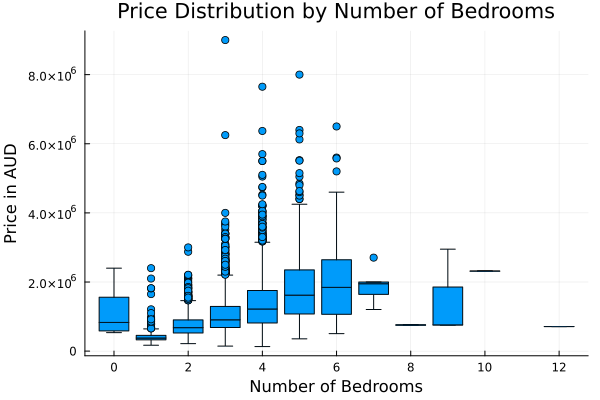

In [188]:
# 2. Boxplot: Price by Number of Bedrooms
@df clean_df boxplot(:Bedroom2, :Price, label = "", xlabel="Number of Bedrooms", ylabel="Price in AUD", title="Price Distribution by Number of Bedrooms")

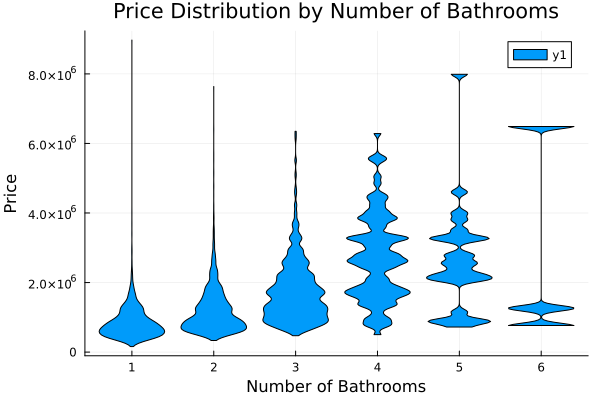

In [187]:
# 3. Violin Plot: Price by Number of Bathrooms
@df clean_df violin(:Bathroom, :Price,  xlabel="Number of Bathrooms", ylabel="Price", title="Price Distribution by Number of Bathrooms")

The above plots, show that with more Bathrooms and bedrooms generally the price of the property does increase. Exceptions do occur however this is the gneral trend. In the plot above, the price varies particuarly for 4, 5 and 6 bedroom places quite substianlly, in small windows. This could be that the more expesnsive groups refer to properties with large amounts of land or are closer to the city. The clumping will be investigated with plots of more variables. 

In [ ]:
# # 5. Correlation Heatmap: Show correlation between numeric variables
# corr_matrix = Matrix(select(clean_df, Not(:Price)))' * Matrix(select(clean_df, Not(:Price))) ./ (nrow(clean_df) - 1)
# heatmap(corr_matrix, title="Correlation Heatmap", xticks=(1:5, ["Rooms", "Landsize", "Bedroom2", "Bathroom", "Car"]),
#         yticks=(1:5, ["Rooms", "Landsize", "Bedroom2", "Bathroom", "Car"]))

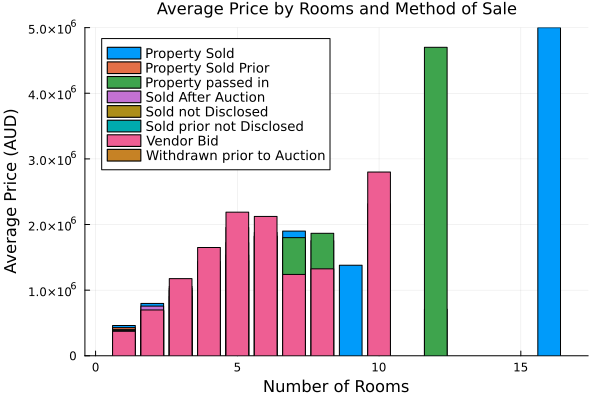

In [5]:

# Group the data and calculate average price, skipping missing values
rooms_methods_df = combine(groupby(df, [:Rooms, :Method]), 
                     :Price => (x -> mean(skipmissing(x))) => :AvgPrice)

# Maps the abbreviated method names to full names
full_method_names = [method_mapping[m] for m in rooms_methods_df.Method]

# Creates the bar plot
bar(rooms_methods_df.Rooms, rooms_methods_df.AvgPrice, group=full_method_names, 
    xlabel="Number of Rooms", ylabel="Average Price (AUD)", 
    title="Average Price by Rooms and Method of Sale",
    titlefontsize=11, legend=:topleft, legendfontsize=9)
       

There are too many plots in the above, as a result and average has been done across the distances and is shown below for better viewing. 

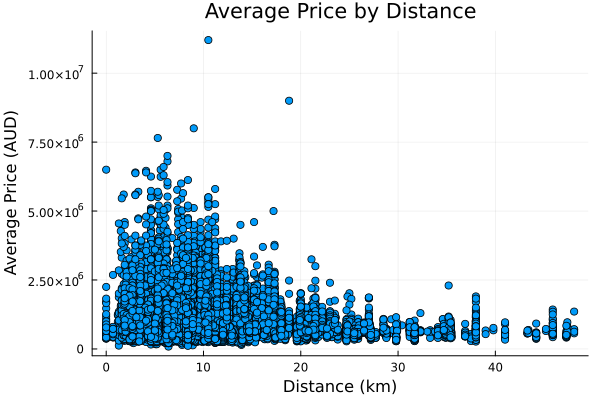

In [82]:

# Create a scatter plot with the average prices by distance
scatter(cleaned_df.Distance, cleaned_df.Price,
    xlabel = "Distance (km)", ylabel = "Average Price (AUD)", title = "Average Price by Distance",
    legend = false)

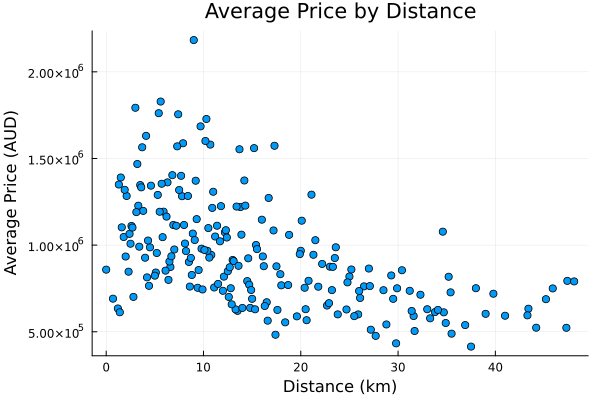

In [18]:
# Group by Distance and calculate the average Price
grouped_df = combine(groupby(cleaned_df, :Distance), :Price => mean => :AvgPrice)

# Create a scatter plot with the average prices by distance
scatter(grouped_df.Distance, grouped_df.AvgPrice,
    xlabel = "Distance (km)", ylabel = "Average Price (AUD)", title = "Average Price by Distance",
    legend = false)